# Analysis of Internet Use by State in the United States

Yukun Zheng, Yuxin Wen and Ziyue Su

# INTRODUCTION

Internet is a necessity in our daily life and facilitates the world in so many aspects, from communication and sharing information with people, to online banking and shopping. Many people even view internet as a utility such as water, electricity and gas. However, do you know how many households in each state of the United States do not have internet, who are these people, and why they do not have internet?

With these questions in mind, we will analyze internet use by state and deduce the potential causes. According to Kaggle, U.S. Census Bureau began asking internet use in American Community Survey in 2013; the dataset contains data for counties with population over 65,000.

Throughout this tutorial, we will collect, process and visualize the data presented in this dataset, as well as perform machine learning techniques on it. We aim to uncover the trends between households without internet connection and potential factors such as their ages, locations and incomes. We will hopefully inform the public that there still exist many households that do not have internet access nowadays.

# REQUIRED TOOLS

We will need the following libraries for this project:
1. pandas
2. matplotlib.pyplot
3. numpy
4. sqlite3
5. seaborn
6. sklearn
7. statsmodels
8. scipy
9. folium
10. heatmap

We highly recommend referring to the following resources for more information about pandas/installation and python 3.6 in general:
1. https://pandas.pydata.org/pandas-docs/stable/install.htm
2. https://docs.python.org/3/

In [1]:
!pip install folium
!pip install graphviz
!conda install graphviz --y
!pip install pydotplus
import sqlite3
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import sklearn
from sklearn import datasets
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn import linear_model
from sklearn.linear_model import LinearRegression
from sklearn import tree
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_validate
from sklearn.ensemble import RandomForestClassifier
from sklearn.datasets import make_classification
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import accuracy_score
from sklearn.metrics import r2_score
from sklearn.metrics import explained_variance_score
from scipy import stats
import statsmodels.api as sm
import statsmodels.formula.api as smf
import folium
from folium.plugins import HeatMap
from numpy.polynomial.polynomial import polyfit

You are using pip version 9.0.3, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
You are using pip version 9.0.3, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.
Solving environment: done


==> WARNING: A newer version of conda exists. <==
  current version: 4.5.8
  latest version: 4.5.11

Please update conda by running

    $ conda update -n base conda



# All requested packages already installed.

You are using pip version 9.0.3, however version 18.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


# 1. DATA COLLECTION:

This is the data collection stage of the data life cycle. Throughout this step, we primarily focus on collecting data from valuable sources.

Here we are scraping data from the local csv file “kaggle_internet.csv” using pandas and then putting the data into a dataframe.

Kaggle has arranged the data into different columns as follows:
1. county
2. state
3. geographic identifier for the county
4. longitude of a point inside the county
5. latitude of the point
6. total population
7. population of different races
8. population of different education levels
9. population living below poverty line
10. population of median age
11. gini index
12. median household income
13. median percent of income spent on rent
14. percent of household without internet access

We will use pand.DataFrame to save the data, because this data structure is very 
convenient, which is two-dimensional matrix that can save different types of objects. Also, there are many powerful funtions that can help us process the data. More info. from: https://pandas.pydata.org/pandas-docs/stable/generated/pandas.DataFrame.drop.html

We will manipulate and analyze the data later throughout this tutorial. The head of the original dataset is printed below:

In [2]:
# SCRAPE DATA FROM THE LOCAL CSV FILE
data = pd.read_csv("kaggle_internet.csv")
data.index = data.index + 1
data.head()

,county,state,GEOID,lon,lat,P_total,P_white,P_black,P_asian,P_native,...,P_some_high_school,P_high_school_equivalent,P_some_college,P_bachelor_and_above,P_below_poverty,median_age,gini_index,median_household_income,median_rent_per_income,percent_no_internet
1,Anchorage Municipality,AK,05000US02020,-149.274354,61.177549,298192,184841.0,16102.0,27142.0,23916.0,...,8196.0,44804.0,66162.0,70713.0,18302,33.0,0.4018,85634,28.0,6.593887
2,Fairbanks North Star Borough,AK,05000US02090,-146.599867,64.690832,100605,75501.0,4385.0,3875.0,7427.0,...,1527.0,14725.0,24570.0,19257.0,9580,30.6,0.3756,77328,25.6,12.102458
3,Matanuska-Susitna Borough,AK,05000US02170,-149.407974,62.182173,104365,86314.0,1019.0,1083.0,5455.0,...,2755.0,21071.0,28472.0,12841.0,9893,34.2,0.4351,69332,29.6,11.156575
4,Baldwin County,AL,05000US01003,-87.746067,30.659218,208563,180484.0,18821.0,914.0,1383.0,...,10506.0,41822.0,46790.0,43547.0,23375,42.4,0.4498,56732,29.3,17.868167
5,Calhoun County,AL,05000US01015,-85.822513,33.771706,114611,NaN,NaN,NaN,NaN,...,8853.0,24761.0,26625.0,12909.0,18193,39.1,0.4692,41687,24.8,23.464932



Below we will take you through the process of data tidying which is a critical step to structure the dataset and facilitate our future analysis.

# 2. DATA PROCESSING:

This is the data processing stage of the data life cycle. During this phase, we essentially attempt to “fix up” the organization of our data so that it will be easier and more readable to analyze.

You can get more information regarding data cleaning and tidying at:
https://realpython.com/python-data-cleaning-numpy-pandas/.

Here we are basically reformatting our dataset in correspondence with the formatting provided by Kaggle. We do so by including the percentages of each population in new columns “percent_something” and then dropping the original population columns.

Performing this step in the data life cycle is crucial in ensuring facilitated manipulation and flexibility for future analysis.

In [3]:
# ADD THE NEW COLUMN "PERCENT_SOMETHING" TO GET THE PERCENTAGE OF POPULATION
# ALSO DROP THE ORIGINAL COLUMN
temp = data.columns.values[6:18]
for i in temp:
    temp_str = i[2:]
    
    # GET THE PERCENTAGE OF EACH TYPES OF PEOPLE
    data["percent_" + temp_str] = 100 * data[i] / data["P_total"]
    
    # DROP THE ORIGINAL COLUMN
    data.drop(i, axis=1, inplace  = True)

data.head()

,county,state,GEOID,lon,lat,P_total,median_age,gini_index,median_household_income,median_rent_per_income,...,percent_asian,percent_native,percent_hawaiian,percent_others,percent_below_middle_school,percent_some_high_school,percent_high_school_equivalent,percent_some_college,percent_bachelor_and_above,percent_below_poverty
1,Anchorage Municipality,AK,05000US02020,-149.274354,61.177549,298192,33.0,0.4018,85634,28.0,...,9.102189,8.020336,2.571833,2.661037,0.749182,2.748565,15.025219,22.187718,23.713916,6.137656
2,Fairbanks North Star Borough,AK,05000US02090,-146.599867,64.690832,100605,30.6,0.3756,77328,25.6,...,3.851697,7.382337,0.499975,2.342826,0.918443,1.517817,14.636449,24.422245,19.141196,9.522390
3,Matanuska-Susitna Borough,AK,05000US02170,-149.407974,62.182173,104365,34.2,0.4351,69332,29.6,...,1.037704,5.226848,0.135103,0.311407,0.322905,2.639774,20.189719,27.281177,12.303933,9.479232
4,Baldwin County,AL,05000US01003,-87.746067,30.659218,208563,42.4,0.4498,56732,29.3,...,0.438237,0.663109,0.000000,0.704344,1.555885,5.037327,20.052454,22.434468,20.879542,11.207645
5,Calhoun County,AL,05000US01015,-85.822513,33.771706,114611,39.1,0.4692,41687,24.8,...,NaN,NaN,NaN,NaN,2.142028,7.724389,21.604384,23.230754,11.263317,15.873694



As we can see, there are missing data in the dataset. We regard the type of missingness as missing at random (MAR), which means the probability of missing data is dependent on the observed data but not the unobserved data. We infer that it is missing at random since we believe some people would refuse to answer questions with respect to their household incomes and education levels.

We will tidy the missing data by mean substitution, where we impute the average from observed cases for all missing values of a variable. More specifically, we will use “df.fillna by mean” to replace each NaN value with the mean of its column.

For more information about handling the missing data you should refer to:
https://machinelearningmastery.com/handle-missing-data-python/.

The head of the resulting tidy dataset is printed below:

In [4]:
# REPLACE THE NAN DATA WITH THE MEAN OF THE COLUMN (MEAN SUBSTITUTION)
# BY USING DF.FILLNA BY MEAN TO FILL THE NAN DATA
temp_mean = data.mean()

for j in data.columns.values[6:18]:
    temp = []
    for i in data[j]:
        if i != i:
            temp.append(temp_mean[j])
        else:
            temp.append(i)
    
    data[j] = temp
        
data.head()

,county,state,GEOID,lon,lat,P_total,median_age,gini_index,median_household_income,median_rent_per_income,...,percent_asian,percent_native,percent_hawaiian,percent_others,percent_below_middle_school,percent_some_high_school,percent_high_school_equivalent,percent_some_college,percent_bachelor_and_above,percent_below_poverty
1,Anchorage Municipality,AK,05000US02020,-149.274354,61.177549,298192,33.0,0.4018,85634,28.0,...,9.102189,8.020336,2.571833,2.661037,0.749182,2.748565,15.025219,22.187718,23.713916,6.137656
2,Fairbanks North Star Borough,AK,05000US02090,-146.599867,64.690832,100605,30.6,0.3756,77328,25.6,...,3.851697,7.382337,0.499975,2.342826,0.918443,1.517817,14.636449,24.422245,19.141196,9.522390
3,Matanuska-Susitna Borough,AK,05000US02170,-149.407974,62.182173,104365,34.2,0.4351,69332,29.6,...,1.037704,5.226848,0.135103,0.311407,0.322905,2.639774,20.189719,27.281177,12.303933,9.479232
4,Baldwin County,AL,05000US01003,-87.746067,30.659218,208563,42.4,0.4498,56732,29.3,...,0.438237,0.663109,0.000000,0.704344,1.555885,5.037327,20.052454,22.434468,20.879542,11.207645
5,Calhoun County,AL,05000US01015,-85.822513,33.771706,114611,39.1,0.4692,41687,24.8,...,3.903036,1.157285,0.197669,3.505234,2.142028,7.724389,21.604384,23.230754,11.263317,15.873694


# 3. EXPLORATORY ANALYSIS AND DATA VISUALIZATION:

This is the exploratory analysis and visualization stage of the data life cycle where we attempt to plot our data in order to observe potential trends. We will also perform statistical analysis in this step in order to obtain better supporting evidence for trends that may be discovered.

Firstly, the map below shows the locations of counties with the highest and lowest Gini index. According to Wikipedia, Gini index is a measure of the income or wealth distribution of a place’s residents and is the most commonly used measurement of inequality.

There are altogether 820 counties within our dataset. The top 30 highest counties are labeled as red and the top 30 lowest are labeled as green. You will know the Gini index of each county by simply moving your mouse over its tag!

As we can see from the map, coastal areas have higher Gini index compared to other areas in the United States, which indicates that coastal areas have a larger gap between the wealthy and poor.

In [5]:
#map the top 30 highest and lowest Gini index counties and observe their location
#put your mouse over the tag to see its gini index
data.sort_values("gini_index",inplace=True,ascending=False)
data.head()

map_osm = folium.Map(location=[39.29, -97.61], zoom_start=3.5)
map_osm
map1=map_osm
index=1
for i,r in data.iterrows():
    a=r['lat']
    b=r['lon']
    tooltip1=str(r['gini_index'])
    if index>=1 and index<=30:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='red'),
                          tooltip=tooltip1).add_to(map1)
    if index>=790 and index <=820:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='green'),
                          tooltip=tooltip1).add_to(map1)
    index=index+1
map1

On the other hand, the map below shows the locations of counties with the highest and lowest percentages of median_age. The top 30 highest counties are labeled as red and the top 30 lowest are labeled as green. We can see that coastal areas (especially Florida) have the highest percentages of median_age. You will know the percentage of each county by simply moving your mouse over its tag!

In [6]:
#pay attention to bottom right
data.sort_values("median_age",inplace=True,ascending=False)
data.head()
map_osm = folium.Map(location=[39.29, -97.61], zoom_start=3.5)
map_osm
map1=map_osm
index=1
for i,r in data.iterrows():
    a=r['lat']
    b=r['lon']
    tooltip1=str(r['median_age'])
    if index>=1 and index<=30:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='red'),
                          tooltip=tooltip1).add_to(map1)
    if index>=790 and index <=820:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='green'),
                          tooltip=tooltip1).add_to(map1)
    index=index+1
map1

The map below shows the locations of counties with the highest and lowest percentages of households having no internet. The top 30 highest counties are labeled as red and the top 30 lowest are labeled as green. It is safe to conclude from the map that north of the United States has lower percent_no_internet compared to south, and we see no correlation between median_age and percent_no_internet. You will know the percentage of each county by simply moving your mouse over its tag!

In [7]:
data.sort_values("percent_no_internet",inplace=True,ascending=False)
data.head()

map_osm = folium.Map(location=[39.29, -97.61], zoom_start=3.5)
map_osm
map1=map_osm
index=1
for i,r in data.iterrows():
    a=r['lat']
    b=r['lon']
    tooltip1=str(r['percent_no_internet'])
    if index>=1 and index<=30:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='red'),
                          tooltip=tooltip1).add_to(map1)
    if index>=790 and index <=820:
        folium.Marker([a,b], popup='', icon=folium.Icon(color='green'),
                          tooltip=tooltip1).add_to(map1)
    index=index+1
map1

The heatmap below shows the graphical representation of households that do not have internet connection. We can see that the huge part of it is from the east.

In [8]:
#simple heatmap
#zoom in
map_osm = folium.Map(location=[39.29, -97.61], zoom_start=3.5)
map_osm
map1=map_osm
x=data[['lat','lon']].values.tolist()
HeatMap(x).add_to(map1)
map1

The map below pinpoints the locations of counties of different Gini index levels. The blue dots represent counties of Gini index that is less or equal to 0.4; the red dots represent counties of Gini index that is between 0.4 and 0.5; and the black dots represent counties of Gini index that is greater than 0.5.

In [9]:
map_osm = folium.Map(location=[39.29, -97.61], zoom_start=3.5)
map_osm
for i, r in data.iterrows():
    color = "black"
    if r["gini_index"] <= 0.4:
        color = "blue"
    elif r["gini_index"] <= 0.5:
        color = "red"
        
    folium.Circle(radius = 10, location = [r["lat"], r["lon"]], popup = "", color = color, fill = True).add_to(map_osm)
        
map_osm

# 4. ANALYSIS, HYPOTHESIS TESTING AND MACHINE LEARNING:

During this phase of the data life cycle, we attempt to perform various modeling techniques such as linear regression to obtain a predictive model of our data. This allows us to predict values for data outside of the scope of our data.

Please visit http://bigdata-madesimple.com/how-to-run-linear-regression-in-python-scikit-learn/ for more information on machine learning techniques.

For example, we will use numpy.polynomial.polynomial to investigate the relationship between poverty and not having internet access.

First plot shows the correlation within the entire nation, while the rest show the correlations within each state. However, majority of the graphs below indicate a positive correlation between gini_index and percent_no_internet. So it is highly possible that areas with larger disparities between the rich and poor have a larger number of households that lack internet connection.

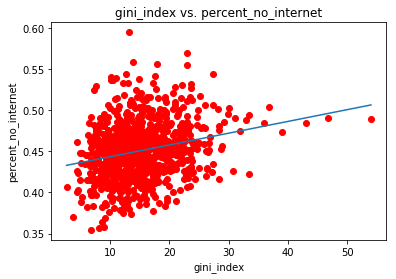

In [10]:
# the plot of gini_index vs. percent_no_internet
plt.plot(data["percent_no_internet"], data["gini_index"], "ro")
b, m = polyfit(data["percent_no_internet"], data["gini_index"],1)
plt.plot(data["percent_no_internet"],b+m*data["percent_no_internet"],'-')
plt.title("gini_index vs. percent_no_internet")
plt.ylabel('percent_no_internet')
plt.xlabel('gini_index')
plt.show()

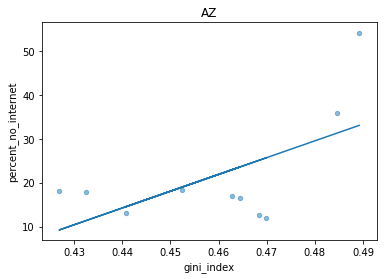

Coefficient: 382.777491604


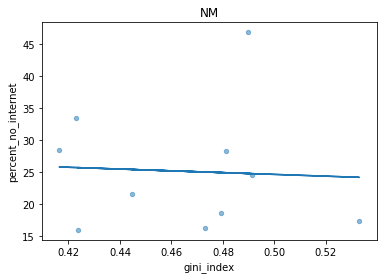

Coefficient: -13.8724375234


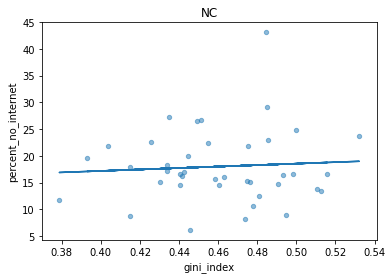

Coefficient: 13.6476748597


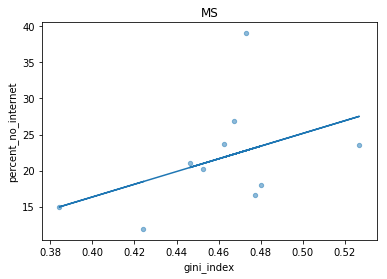

Coefficient: 88.1010060635


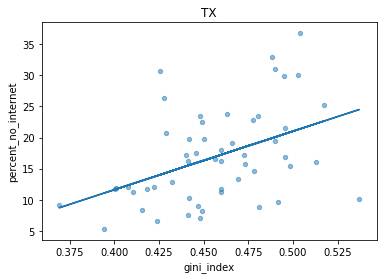

Coefficient: 93.9535099791


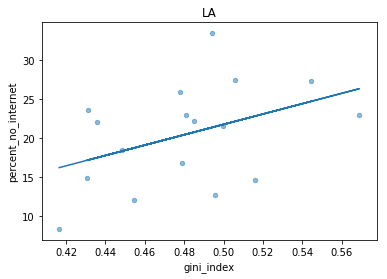

Coefficient: 66.1803087262


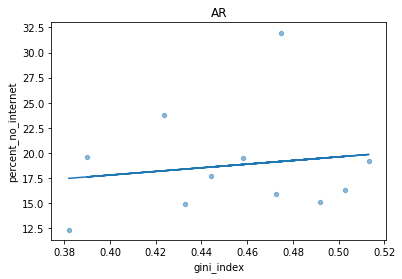

Coefficient: 18.127031613


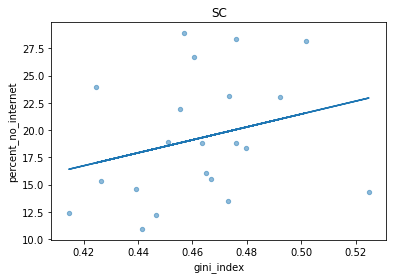

Coefficient: 59.2427372518


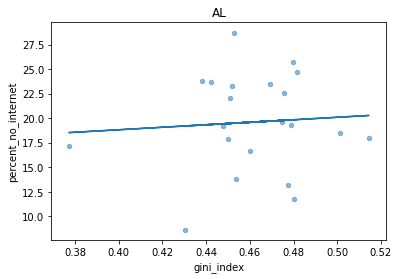

Coefficient: 12.7113549328


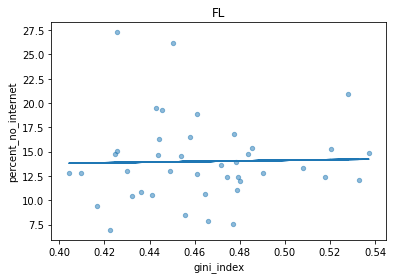

Coefficient: 3.14197461575


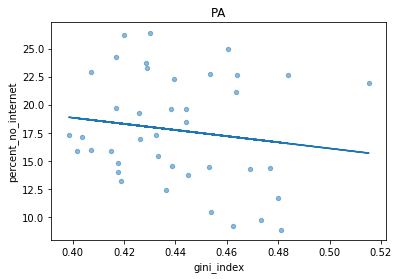

Coefficient: -27.3070478521


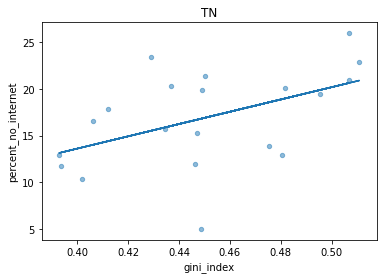

Coefficient: 65.7172581066


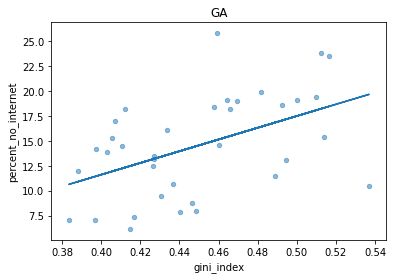

Coefficient: 58.8065049515


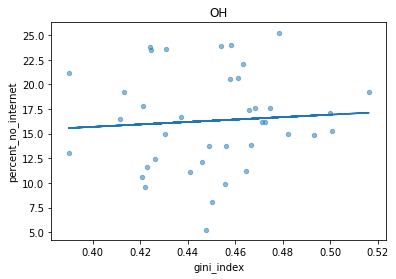

Coefficient: 12.3277516973


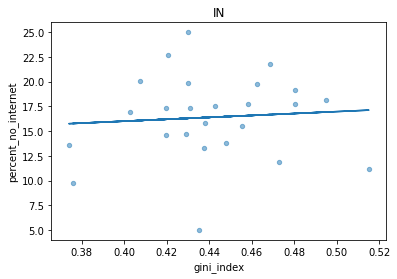

Coefficient: 9.67768207381


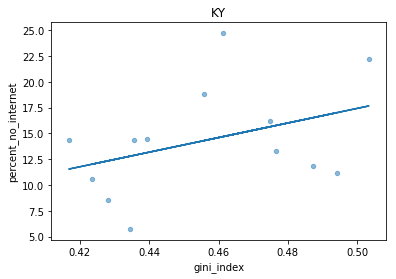

Coefficient: 70.6139569207


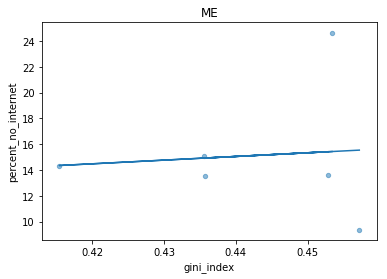

Coefficient: 28.5169520921


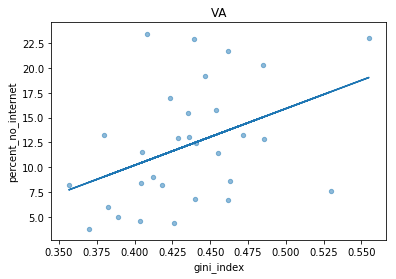

Coefficient: 57.0017778822


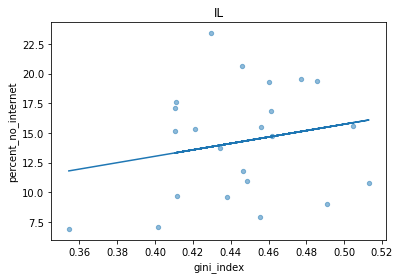

Coefficient: 27.0392365902


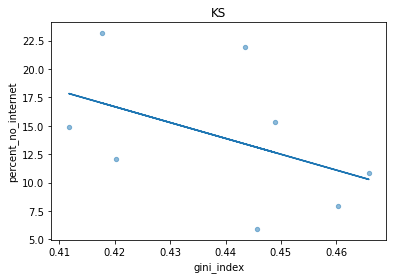

Coefficient: -139.449936453


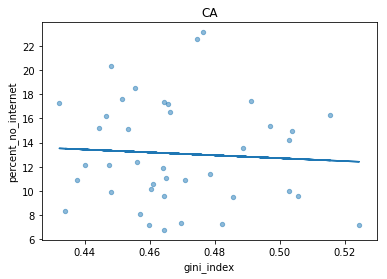

Coefficient: -11.9718224792


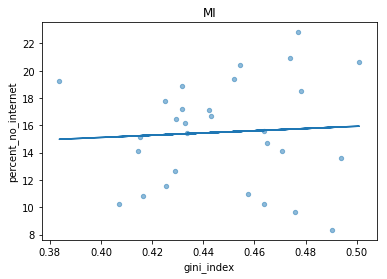

Coefficient: 8.17249130225


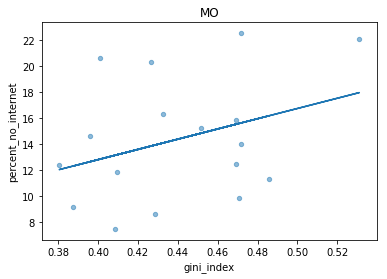

Coefficient: 39.4129850273


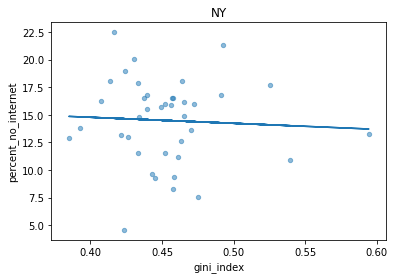

Coefficient: -5.44544370471


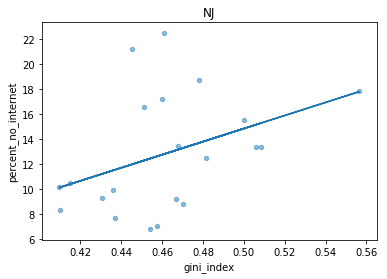

Coefficient: 52.2006736772


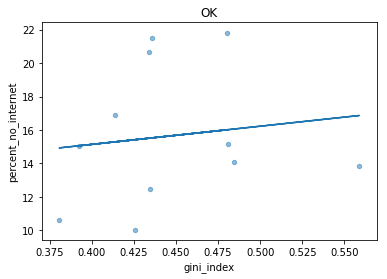

Coefficient: 10.8606946205


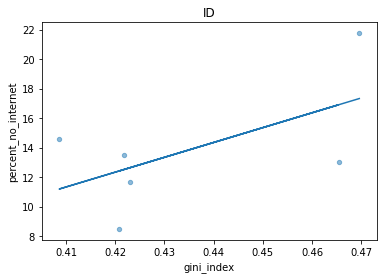

Coefficient: 100.668188608


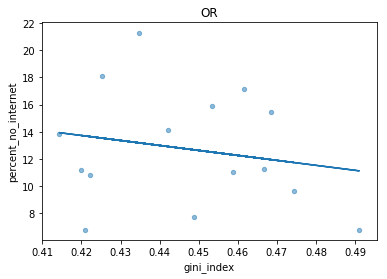

Coefficient: -36.5680916496


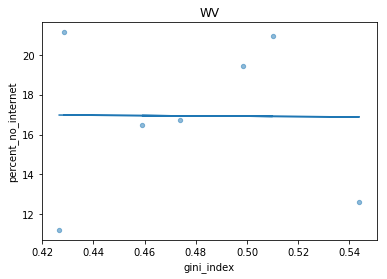

Coefficient: -0.808008904589


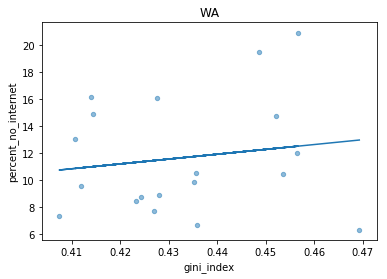

Coefficient: 35.8419402753


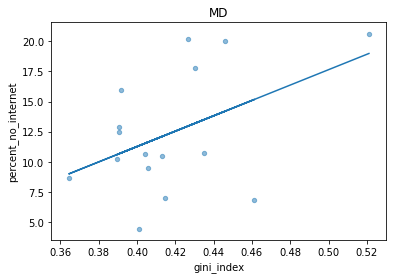

Coefficient: 63.7745839594


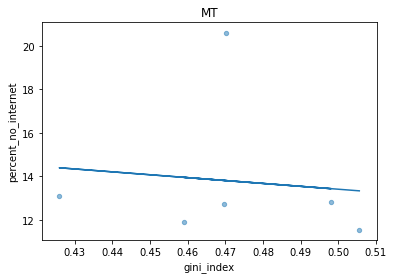

Coefficient: -13.3083555065


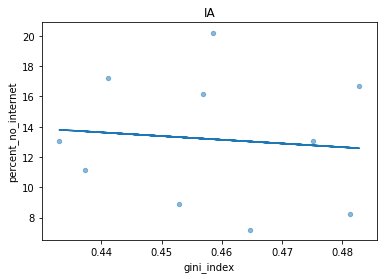

Coefficient: -24.4346920587


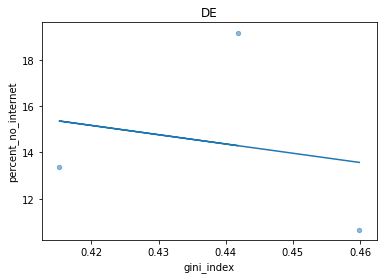

Coefficient: -39.9861376168


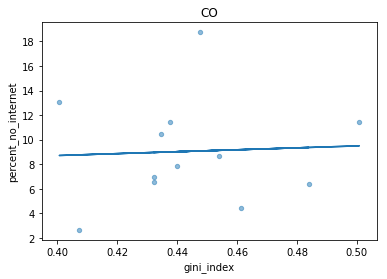

Coefficient: 7.81955538538


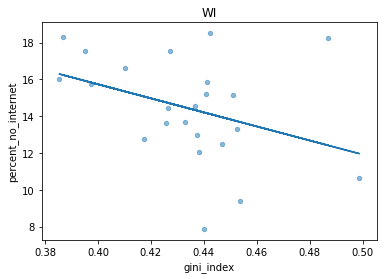

Coefficient: -38.2130017695


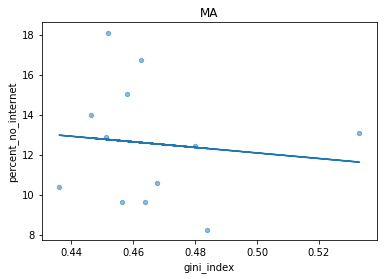

Coefficient: -13.9071234141


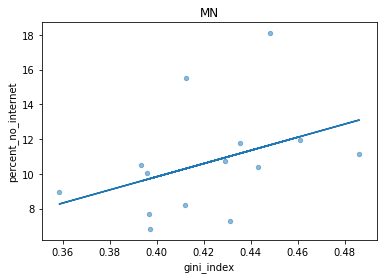

Coefficient: 37.9297599559


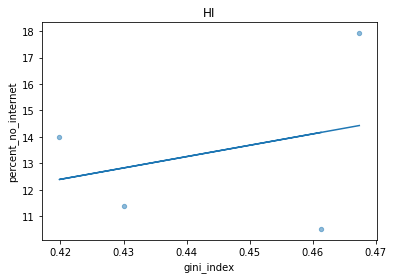

Coefficient: 42.8754634913


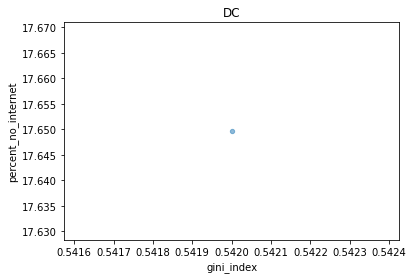

Coefficient: 0.0


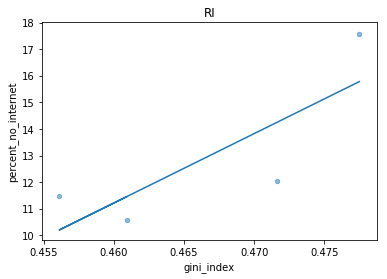

Coefficient: 260.741411407


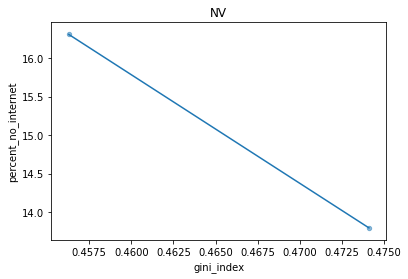

Coefficient: -140.871395497


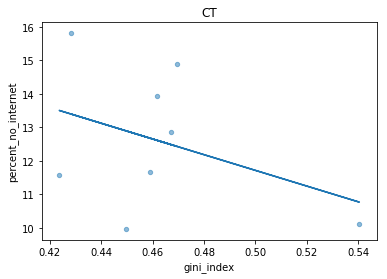

Coefficient: -23.4714625959


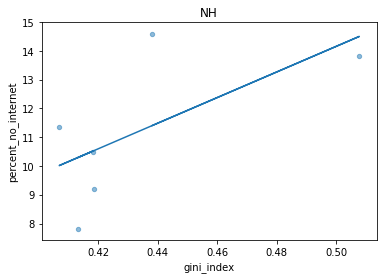

Coefficient: 44.547562955


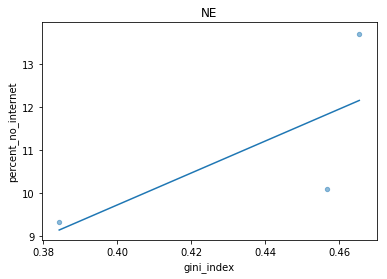

Coefficient: 37.1246234274


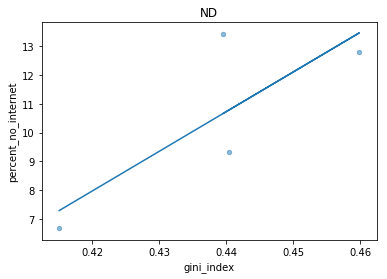

Coefficient: 137.865953936


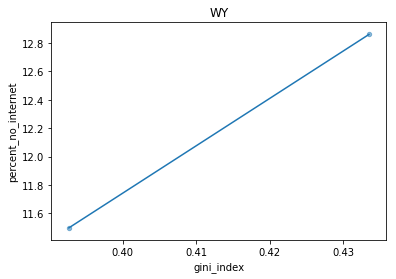

Coefficient: 33.4019049476


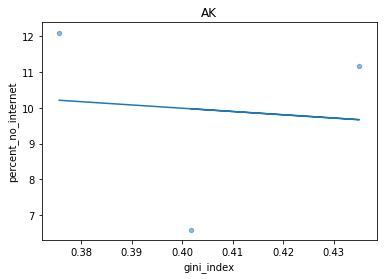

Coefficient: -9.12123648978


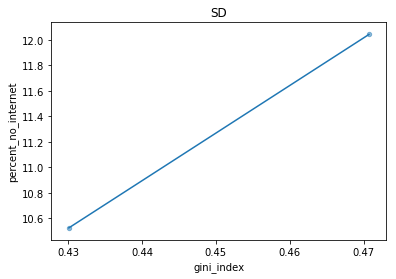

Coefficient: 37.3879505863


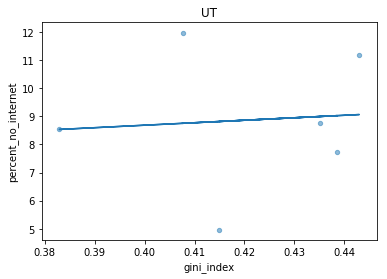

Coefficient: 8.81278813702


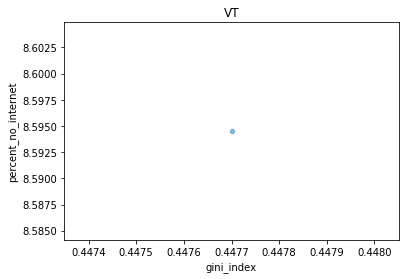

Coefficient: 0.0


In [11]:
for i in data["state"].unique():
    temp = data.loc[data["state"] == i]

    regression = linear_model.LinearRegression()
    reg = smf.ols('gini_index ~ percent_no_internet', data = temp).fit()

    year_vector = [temp['gini_index'].tolist()]
    lifeExp_vector = [temp['percent_no_internet'].tolist()]
    year = np.transpose(year_vector)
    lifeExp = np.transpose(lifeExp_vector)

    regression = regression.fit(year, lifeExp)
    plt.plot(year, regression.predict(year))
    plt.scatter(temp["gini_index"], temp["percent_no_internet"], s=np.pi*6, alpha=0.5)
    plt.title(i)
    plt.ylabel('percent_no_internet')
    plt.xlabel('gini_index')
    plt.show()
    print('Coefficient:', regression.coef_[0][0])

This plot reveals a positive correlation between gini_index and percent_below_poverty, which implies that areas with larger gaps between the rich and poor have higher rates of households living below poverty.

We already know that percent_no_internet correlates with gini_index positively, and since percent_below_poverty also correlates with gini_index positively, it is highly likely that poverty is one of the many factors that leads to households not having internet access.

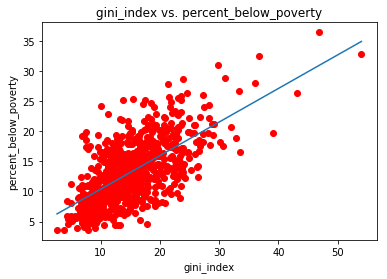

In [12]:
plt.plot(data["percent_no_internet"], data["percent_below_poverty"], "ro")
b, m = polyfit(data["percent_no_internet"], data["percent_below_poverty"],1)
plt.plot(data["percent_no_internet"],b+m*data["percent_no_internet"],'-')
plt.title("gini_index vs. percent_below_poverty")
plt.ylabel('percent_below_poverty')
plt.xlabel('gini_index')
plt.show()

Here we process data for performing marchine learning later. We handle the missing data by dropping the NaN values. We will investigate three potential factors which are age, location and income.

In [13]:
#drop nan data, rows number: 820->605
data.dropna(axis = 0, inplace = True)
print(data['percent_no_internet'])

#data.apply(LabelEncoder().fit_transform)
data['lon']=LabelEncoder().fit_transform(data['lon'])
data['lat']=LabelEncoder().fit_transform(data['lat'])
data['P_total']=LabelEncoder().fit_transform(data['P_total'])
data['median_age']=LabelEncoder().fit_transform(data['median_age'])
data['median_household_income']=LabelEncoder().fit_transform(data['median_household_income'])
data['percent_no_internet']=data['percent_no_internet']*100
data['percent_no_internet']=LabelEncoder().fit_transform(data['percent_no_internet'])
X = data[ ["lon", "lat", "P_total", 
           "median_age", "median_household_income" ]].values
y = data["percent_no_internet"].values

y

36     54.011390
481    46.812223
433    43.097755
392    39.018513
730    36.741831
41     36.002025
484    33.464832
289    33.416936
707    32.916149
29     31.988785
687    31.026814
702    30.738775
684    30.132300
705    29.879940
412    29.193792
642    28.896004
7      28.720009
486    28.398871
646    28.351433
478    28.308758
652    28.207121
287    27.426448
278    27.304935
434    27.293452
142    27.272079
393    26.840496
644    26.740781
436    26.643688
406    26.568402
722    26.417238
         ...    
469     6.818772
740     6.814909
578     6.811800
591     6.808063
75      6.782741
758     6.691950
446     6.682732
688     6.667981
778     6.638693
1       6.593887
93      6.587986
88      6.382652
779     6.319427
158     6.159024
439     6.130938
757     6.051183
257     5.911190
274     5.717658
732     5.321011
537     5.242141
752     5.030331
237     5.021895
678     5.007384
736     4.965685
512     4.594097
756     4.583449
314     4.451671
744     4.3976

array([817, 816, 815, 814, 813, 812, 811, 810, 809, 808, 807, 806, 805,
       804, 803, 802, 801, 800, 799, 798, 797, 796, 795, 794, 793, 792,
       791, 790, 789, 788, 787, 786, 785, 784, 783, 782, 781, 780, 779,
       778, 777, 776, 775, 774, 773, 772, 771, 770, 769, 768, 767, 766,
       765, 764, 763, 762, 761, 760, 759, 758, 757, 756, 755, 754, 753,
       752, 751, 750, 749, 748, 747, 746, 745, 744, 743, 742, 741, 740,
       739, 738, 737, 736, 735, 734, 733, 732, 731, 730, 729, 728, 727,
       726, 725, 724, 723, 722, 721, 720, 719, 718, 717, 716, 715, 714,
       713, 712, 711, 710, 709, 708, 707, 706, 705, 704, 703, 702, 701,
       700, 699, 698, 697, 696, 695, 694, 693, 692, 691, 690, 689, 688,
       687, 686, 685, 684, 683, 682, 681, 680, 679, 678, 677, 676, 675,
       674, 673, 672, 671, 670, 669, 668, 667, 666, 665, 664, 663, 662,
       661, 660, 659, 658, 657, 656, 655, 654, 653, 652, 651, 650, 649,
       648, 647, 646, 645, 644, 643, 642, 641, 640, 639, 638, 63

Here we use r2 score and explained variance score to evaluate the accuary of our models, and the highest we could get is 1. The result is as follows:

1. the r2 score for decision tree is 0.894689179089
2. the explained variance score for decision tree is 0.895552965701
3. the r2 score for random forest is 0.869185062941
4. the explained variance score for random forest is 0.870612642108

The four numbers we get are all very close to 1, which indicates that our models are rather accurate.

In [14]:
kf=KFold(n_splits=10)

for train_index, test_index in kf.split(X):
    X_train, X_test = X[train_index], X[test_index]
    m,n=X_test.shape
    y_train, y_test = y[train_index], y[test_index]
    clf = tree.DecisionTreeRegressor()
    clf = clf.fit(X_train, y_train)
    
    rf = RandomForestRegressor()
    rf.fit(X_train, y_train)

#use r2 score to evaluate the accuary of models
#best possible r2 score is 1.0
#in our case, these are two very good r2 score. 

#Also use explained_variance_score 
y_prediction1=clf.predict(X)
print(r2_score(y, y_prediction1))
print(explained_variance_score(y,y_prediction1))

y_prediction2=rf.predict(X)
print(r2_score(y, y_prediction2))
print(explained_variance_score(y,y_prediction2))

0.920518499954
0.924772924564
0.882198730026
0.887297891294


Below represents a visualization of the decision tree:

In [15]:
#clf tree viz
#took a really long time to run
from sklearn.externals.six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus
dd = StringIO()
export_graphviz(clf, out_file=dd, filled=True, rounded=True, 
                feature_names=["lon", "lat", "P_total", 
           "median_age", "median_household_income"])
viz1 = pydotplus.graph_from_dot_data(dd.getvalue())  
Image(viz1.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.677564 to fit




Forest is a set of plenty of trees so it is rather complicated to visualize it. But we can still get a general idea by visualizing the first tree in our forest as follows:

In [16]:
dd = StringIO()
export_graphviz(rf.estimators_[0], out_file=dd, filled=True, rounded=True, 
                feature_names=["lon", "lat", "P_total", "median_age", "median_household_income"])
viz2 = pydotplus.graph_from_dot_data(dd.getvalue())  
Image(viz2.create_png())

# 5. INSIGHT AND POLICY DECISIONS:

This is the phase of the life cycle where we attempt to utilize our data analysis to draw conclusions and potentially infer certain portions of our data.

Based on our observations throughout our analysis and modeling, we can suggest that:

1. The recent 2016 data shows that over a quarter of households in many counties are still lacking internet connection.
2. Poverty is one of the many factors that leads to households not having internet access.

Overall, we want to inform the public that there are still many households today that do not have internet connection. The government should endeavor to provide internet access for more low-income families, so they will also get to enjoy the convenience that internet brings to us today.

Lastly, if we conducted further analysis, we would expand our dataset and investigate other factors such as the education levels of households.